In [51]:
# Import libraries and dependencies

import pandas as pd
import numpy as np
import pyarrow.feather as feather

from sklearn.preprocessing import StandardScaler
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score

import plotly.express as px
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import FuncAnimation, writers


In [52]:
# Load joint id's CSV

joint_ids_df = pd.read_csv("./joint_ids.csv")

# Load apache arrow files

# As one means of checking if completed each data set
# "#Completed" is used and dataset is commented out

#Completed
sched_id429650_pitcher669302 = feather.read_feather("./Resources/sched_id429650_pitcher669302")
#Completed
#sched_id429650_pitcher680689 = feather.read_feather("./Resources/sched_id429650_pitcher680689")
#Completed
#sched_id429722_pitcher554430 = feather.read_feather("./Resources/sched_id429722_pitcher554430")
#Completed
#sched_id429722_pitcher642547 = feather.read_feather("./Resources/sched_id429722_pitcher642547")
#Completed
#sched_id429804_pitcher554430 = feather.read_feather("./Resources/sched_id429804_pitcher554430")
#Completed
#sched_id429804_pitcher641712 = feather.read_feather("./Resources/sched_id429804_pitcher641712")
#Completed
#sched_id430322_pitcher543243 = feather.read_feather("./Resources/sched_id430322_pitcher543243")
#Completed
#sched_id430322_pitcher669302 = feather.read_feather("./Resources/sched_id430322_pitcher669302")

In [53]:
# Data typing/info and import review

display(joint_ids_df.info())
display(joint_ids_df.head())
display(sched_id430322_pitcher669302.info())
display(sched_id430322_pitcher669302.head())
display(sched_id430322_pitcher669302.tail())


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29 entries, 0 to 28
Data columns (total 3 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   joint_type_id  29 non-null     int64 
 1   joint_type     29 non-null     object
 2   hawkeye        29 non-null     object
dtypes: int64(1), object(2)
memory usage: 828.0+ bytes


None

,joint_type_id,joint_type,hawkeye
0,1,left ankle,lAnkle
1,2,left ear,lEar
2,3,left elbow,lElbow
3,4,left eye,lEye
4,5,left hip,lHip


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1353664 entries, 0 to 1353663
Data columns (total 10 columns):
 #   Column           Non-Null Count    Dtype  
---  ------           --------------    -----  
 0   sched_id         1353664 non-null  int32  
 1   joint_type_id    1353664 non-null  uint8  
 2   time             1353664 non-null  float64
 3   x                1353664 non-null  float32
 4   y                1353664 non-null  float32
 5   z                1353664 non-null  float32
 6   astros_pitch_id  1353664 non-null  int64  
 7   pitcher_id       1353664 non-null  int64  
 8   bats             1353664 non-null  object 
 9   throws           1353664 non-null  object 
dtypes: float32(3), float64(1), int32(1), int64(2), object(2), uint8(1)
memory usage: 73.6+ MB


None

,sched_id,joint_type_id,time,x,y,z,astros_pitch_id,pitcher_id,bats,throws
0,430322,1,-2.000,1.2930,60.172298,1.2119,1,669302,R,R
1,430322,1,-1.997,1.2939,60.173199,1.2093,1,669302,R,R
2,430322,1,-1.993,1.2924,60.174500,1.2106,1,669302,R,R
3,430322,1,-1.990,1.2936,60.174801,1.2092,1,669302,R,R
4,430322,1,-1.987,1.2929,60.174301,1.2085,1,669302,R,R


,sched_id,joint_type_id,time,x,y,z,astros_pitch_id,pitcher_id,bats,throws
1353659,430322,18,0.998,2.4612,53.310101,5.8643,140,669302,R,R
1353660,430322,18,1.001,2.4739,53.331501,5.8481,140,669302,R,R
1353661,430322,18,1.005,2.4868,53.350101,5.8341,140,669302,R,R
1353662,430322,18,1.008,2.5004,53.369202,5.8226,140,669302,R,R
1353663,430322,18,1.011,2.5145,53.385101,5.8097,140,669302,R,R


In [54]:
merged_df = pd.merge(sched_id430322_pitcher669302, joint_ids_df, on='joint_type_id', how='left')
merged_df.dropna(inplace=True)
display(merged_df.info())
display(merged_df.head())
display(merged_df.tail())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1353664 entries, 0 to 1353663
Data columns (total 12 columns):
 #   Column           Non-Null Count    Dtype  
---  ------           --------------    -----  
 0   sched_id         1353664 non-null  int32  
 1   joint_type_id    1353664 non-null  uint8  
 2   time             1353664 non-null  float64
 3   x                1353664 non-null  float32
 4   y                1353664 non-null  float32
 5   z                1353664 non-null  float32
 6   astros_pitch_id  1353664 non-null  int64  
 7   pitcher_id       1353664 non-null  int64  
 8   bats             1353664 non-null  object 
 9   throws           1353664 non-null  object 
 10  joint_type       1353664 non-null  object 
 11  hawkeye          1353664 non-null  object 
dtypes: float32(3), float64(1), int32(1), int64(2), object(4), uint8(1)
memory usage: 94.2+ MB


None

,sched_id,joint_type_id,time,x,y,z,astros_pitch_id,pitcher_id,bats,throws,joint_type,hawkeye
0,430322,1,-2.000,1.2930,60.172298,1.2119,1,669302,R,R,left ankle,lAnkle
1,430322,1,-1.997,1.2939,60.173199,1.2093,1,669302,R,R,left ankle,lAnkle
2,430322,1,-1.993,1.2924,60.174500,1.2106,1,669302,R,R,left ankle,lAnkle
3,430322,1,-1.990,1.2936,60.174801,1.2092,1,669302,R,R,left ankle,lAnkle
4,430322,1,-1.987,1.2929,60.174301,1.2085,1,669302,R,R,left ankle,lAnkle


,sched_id,joint_type_id,time,x,y,z,astros_pitch_id,pitcher_id,bats,throws,joint_type,hawkeye
1353659,430322,18,0.998,2.4612,53.310101,5.8643,140,669302,R,R,right wrist,rWrist
1353660,430322,18,1.001,2.4739,53.331501,5.8481,140,669302,R,R,right wrist,rWrist
1353661,430322,18,1.005,2.4868,53.350101,5.8341,140,669302,R,R,right wrist,rWrist
1353662,430322,18,1.008,2.5004,53.369202,5.8226,140,669302,R,R,right wrist,rWrist
1353663,430322,18,1.011,2.5145,53.385101,5.8097,140,669302,R,R,right wrist,rWrist


In [55]:
# 3D over time Visualization function

# Joints for lefty or righty

joint_types_right = [13,15,17,18]
joint_types_left = [3,5,7,8]

def plot_joint_movements(df, joint_types):
    
    filtered_df = df[df["joint_type_id"].isin(joint_types)]

    print(filtered_df.shape)
    print(filtered_df)

    fig = px.scatter_3d(filtered_df, x='x', y='y', z='z',
                        animation_frame='time', color='joint_type',
                        size_max=3)

    fig.update_layout(title='3D Movement of Specified Joints Over Time')
    
    return fig

In [56]:
# Test whether pitcher is lefy or righty
# and assign to joint_types

if (merged_df["throws"].iloc[0]) == "R":
    joint_types = joint_types_right
else:
    joint_types = joint_types_left

# Plot 3D positioning over time of assigned joints
# see legend on plot

plot = plot_joint_movements(merged_df, joint_types=joint_types)

plot.show()

plot.write_html("./images_and_output_data/uncleaned_3d_plot.html")

(338416, 12)
         sched_id  joint_type_id   time       x          y       z  \
9000       430322             13 -2.000  0.0673  60.856201  5.0710   
9001       430322             13 -1.997  0.0758  60.853802  5.0720   
9002       430322             13 -1.993  0.0767  60.851898  5.0682   
9003       430322             13 -1.990  0.0822  60.846901  5.0660   
9004       430322             13 -1.987  0.0843  60.838600  5.0692   
...           ...            ...    ...     ...        ...     ...   
1353659    430322             18  0.998  2.4612  53.310101  5.8643   
1353660    430322             18  1.001  2.4739  53.331501  5.8481   
1353661    430322             18  1.005  2.4868  53.350101  5.8341   
1353662    430322             18  1.008  2.5004  53.369202  5.8226   
1353663    430322             18  1.011  2.5145  53.385101  5.8097   

         astros_pitch_id  pitcher_id bats throws   joint_type hawkeye  
9000                   1      669302    R      R  right elbow  rElbow  
90

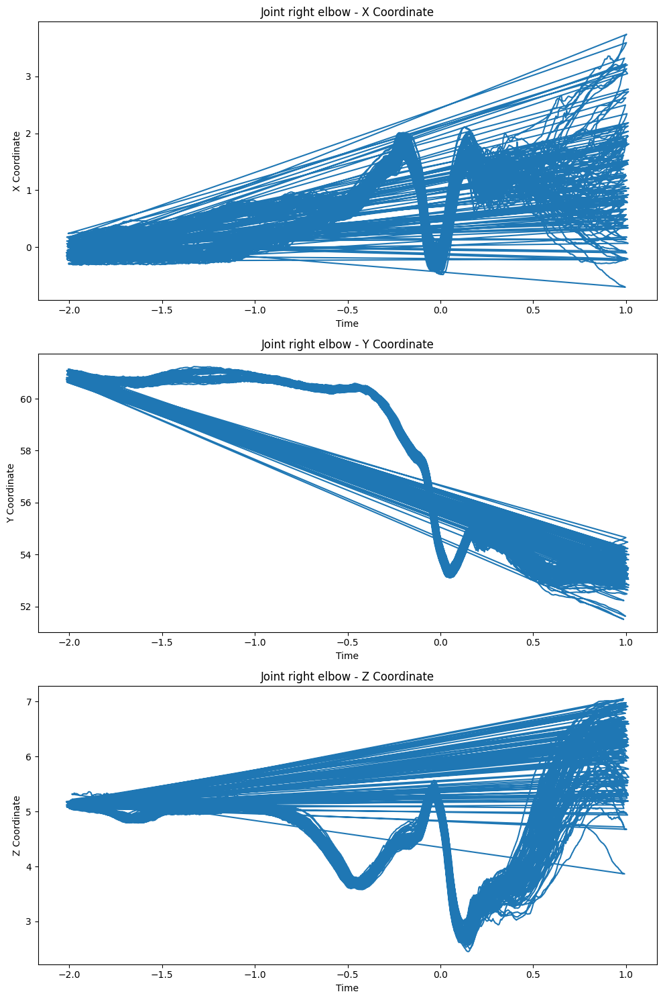

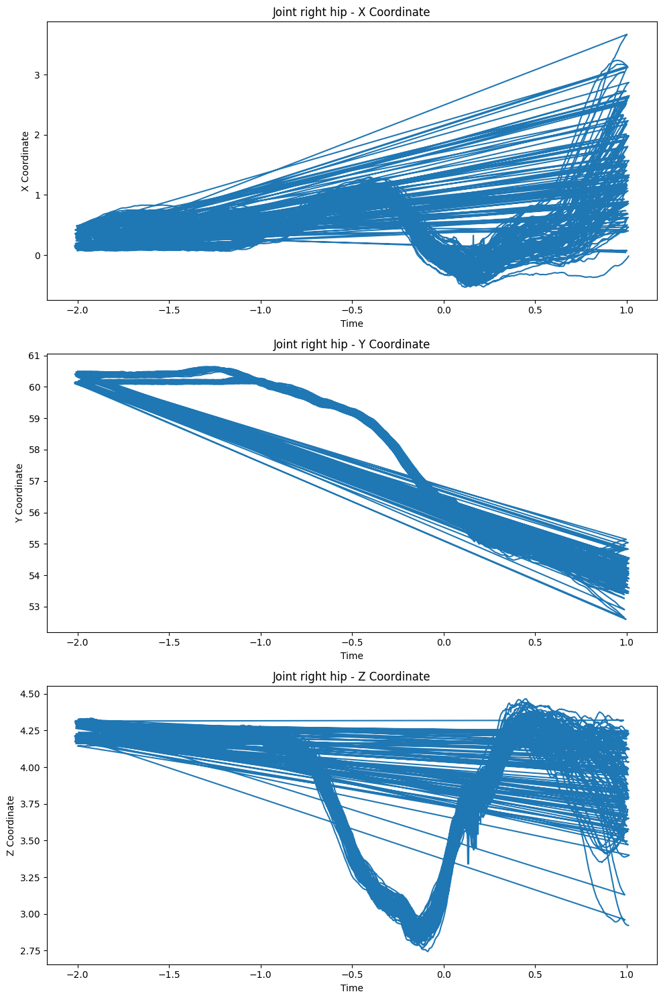

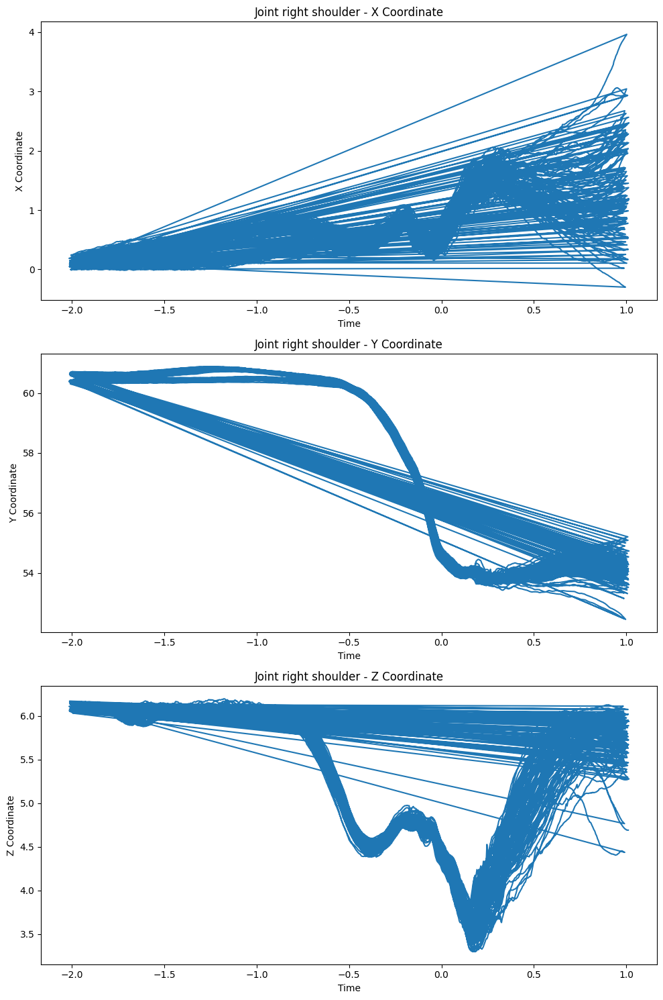

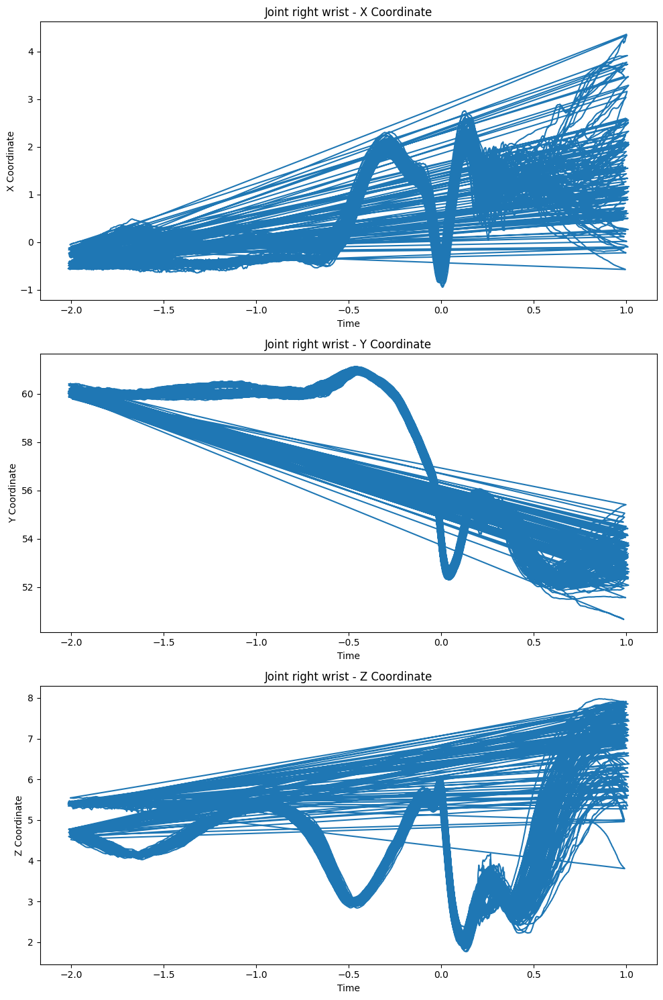

In [57]:
# 2D visualization of each joint of each axis over time

joint_ids_dict = dict(zip(joint_ids_df['joint_type_id'], joint_ids_df['joint_type']))

for joint_type_id in joint_types:
    subset = merged_df[merged_df['joint_type_id'] == joint_type_id]
    fig, axs = plt.subplots(3, 1, figsize=(10, 15))

    # Get the joint type for the current plot/joint_type_id

    joint_type = joint_ids_dict[joint_type_id]
    
    # Plot x, y, z coordinates for the current joint_type_id
    axs[0].plot(subset['time'], subset['x'])
    axs[0].set_title(f'Joint {joint_type} - X Coordinate')
    axs[0].set_xlabel('Time')
    axs[0].set_ylabel('X Coordinate')
    
    axs[1].plot(subset['time'], subset['y'])
    axs[1].set_title(f'Joint {joint_type} - Y Coordinate')
    axs[1].set_xlabel('Time')
    axs[1].set_ylabel('Y Coordinate')

    axs[2].plot(subset['time'], subset['z'])
    axs[2].set_title(f'Joint {joint_type} - Z Coordinate')
    axs[2].set_xlabel('Time')
    axs[2].set_ylabel('Z Coordinate')
    
    plt.tight_layout()
    plt.show()


In [58]:
# Apply DBSCAN to help identify raw data outliers for x,y,z to joint_types

# Identify joints to be scanned

filtered_df = merged_df[merged_df["joint_type_id"].isin(joint_types)]

def apply_dbscan(group,eps=1.25,min_samples=10):
    scaler = StandardScaler()
    X_scaled = np.stack([
        scaler.fit_transform(group[["x"]]).flatten(),
        scaler.fit_transform(group[["y"]]).flatten(),
        scaler.fit_transform(group[["z"]]).flatten()
    ],axis=-1)
    
    #X_scaled = scaler.fit_transform(group[["x","y","z"]])
    dbscan = DBSCAN(eps=eps, min_samples=min_samples)
    #group["dbscan_cluster"] = dbscan.fit_predict(X_scaled)
    group["dbscan_cluster"] = dbscan.fit_predict(X_scaled)
    return group

# Apply DBSCAN to each group of data
grouped = filtered_df.groupby(['joint_type_id',"time"])
dbscan_df = grouped.apply(apply_dbscan)

# Filter out outliers (noise points are labeled as -1)
cleaned_df = dbscan_df[dbscan_df['dbscan_cluster'] != -1]

/var/folders/sr/78cv2dx14kgdcwtf90634z580000gn/T/ipykernel_8667/1050584917.py:23: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



In [59]:
# Raw data processed review

display(merged_df.shape[0])
display(cleaned_df.shape[0])
display(cleaned_df["dbscan_cluster"].value_counts())
display(cleaned_df.info())
display(cleaned_df.head())
display(cleaned_df.tail())


1353664

205664

dbscan_cluster
0    160391
1     45273
Name: count, dtype: int64

<class 'pandas.core.frame.DataFrame'>
MultiIndex: 205664 entries, (13, -1.9929999999999999, 9002) to (18, 1.0, 1080059)
Data columns (total 13 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   sched_id         205664 non-null  int32  
 1   joint_type_id    205664 non-null  uint8  
 2   time             205664 non-null  float64
 3   x                205664 non-null  float32
 4   y                205664 non-null  float32
 5   z                205664 non-null  float32
 6   astros_pitch_id  205664 non-null  int64  
 7   pitcher_id       205664 non-null  int64  
 8   bats             205664 non-null  object 
 9   throws           205664 non-null  object 
 10  joint_type       205664 non-null  object 
 11  hawkeye          205664 non-null  object 
 12  dbscan_cluster   205664 non-null  int64  
dtypes: float32(3), float64(1), int32(1), int64(3), object(4), uint8(1)
memory usage: 28.0+ MB


None

sched_id  joint_type_id   time       x  \
joint_type_id time                                                    
13            -1.993 9002      430322             13 -1.993  0.0767   
                     52205     430322             13 -1.993  0.0283   
                     81015     430322             13 -1.993  0.0241   
                     124220    430322             13 -1.993 -0.0011   
                     138622    430322             13 -1.993  0.0727   

                                     y       z  astros_pitch_id  pitcher_id  \
joint_type_id time                                                            
13            -1.993 9002    60.851898  5.0682                1      669302   
                     52205   60.929401  5.1099                4      669302   
                     81015   60.975498  5.1202                6      669302   
                     124220  60.930698  5.1234                9      669302   
                     138622  60.898998  5.0862               10      669302   

                            bats throws   joint_type hawkeye  dbscan_cluster  
joint_type_id time                                                            
13            -1.993 9002      R      R  right elbow  rElbow               0  
                     52205     R      R  right elbow  rElbow               0  
                     81015     L      R  right elbow  rElbow               0  
                     124220    L      R  right elbow  rElbow               0  
                     138622    L      R  right elbow  rElbow               0

sched_id  joint_type_id  time       x          y  \
joint_type_id time                                                             
18            1.0  763229     430322             18   1.0  1.1559  54.190701   
                   907231     430322             18   1.0  1.8996  53.290501   
                   936031     430322             18   1.0  1.0383  53.417301   
                   1008046    430322             18   1.0  1.8105  53.347500   
                   1080059    430322             18   1.0  2.2800  53.818802   

                                 z  astros_pitch_id  pitcher_id bats throws  \
joint_type_id time                                                            
18            1.0  763229   7.3437               74      669302    R      R   
                   907231   6.7855               84      669302    L      R   
                   936031   7.3476               86      669302    R      R   
                   1008046  6.7683               91      669302    R      R   
                   1080059  7.1063              111      669302    L      R   

                             joint_type hawkeye  dbscan_cluster  
joint_type_id time                                               
18            1.0  763229   right wrist  rWrist               0  
                   907231   right wrist  rWrist               0  
                   936031   right wrist  rWrist               0  
                   1008046  right wrist  rWrist               0  
                   1080059  right wrist  rWrist               0

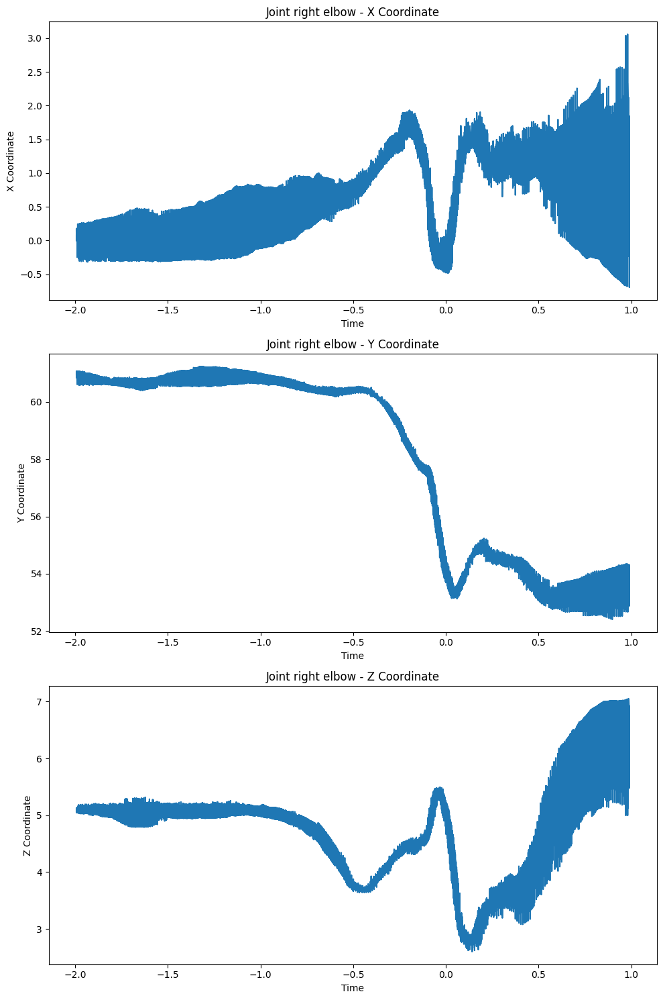

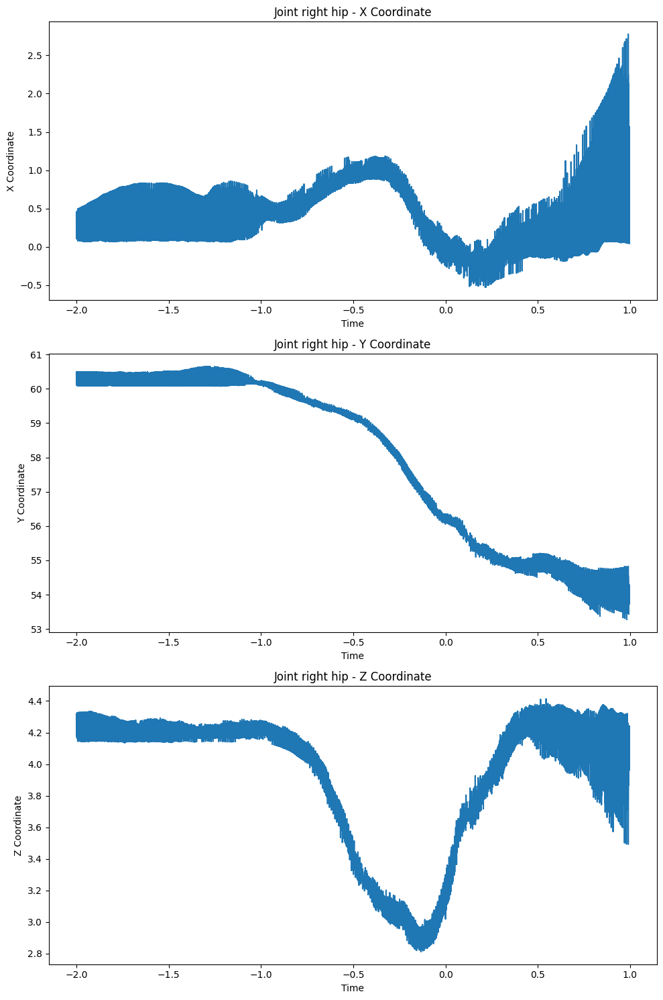

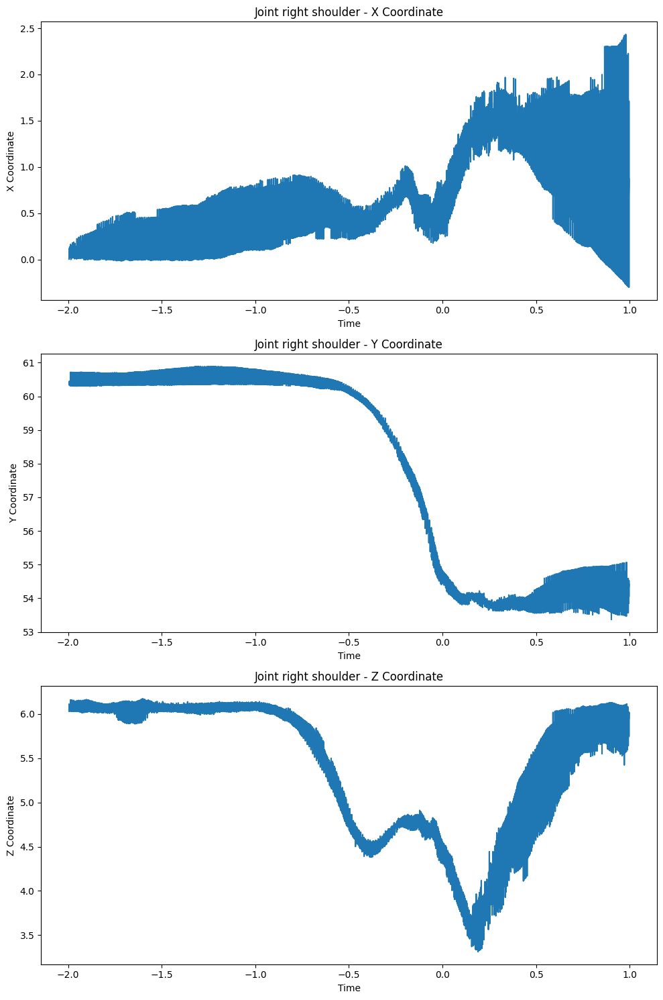

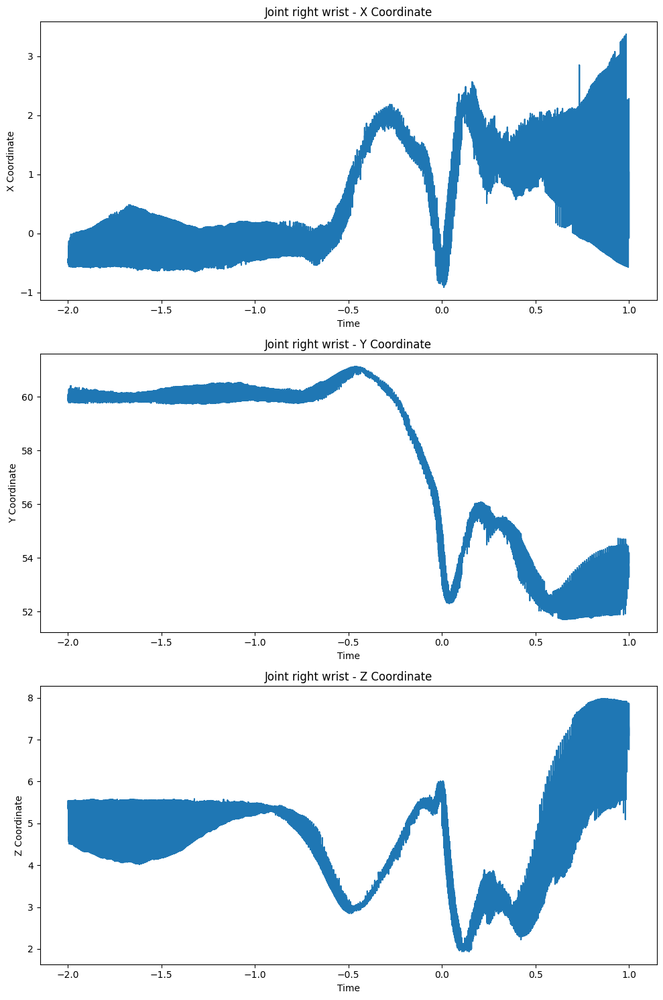

In [60]:
# Plot claned data for each joint

for joint_type_id in joint_types:
    subset = cleaned_df[cleaned_df['joint_type_id'] == joint_type_id]
    fig, axs = plt.subplots(3, 1, figsize=(10, 15))

    # Get the joint type for the current plot/joint_type_id

    joint_type = joint_ids_dict[joint_type_id]
    
    # Plot x, y, z coordinates for the current joint_type_id
    axs[0].plot(subset['time'], subset['x'])
    axs[0].set_title(f'Joint {joint_type} - X Coordinate')
    axs[0].set_xlabel('Time')
    axs[0].set_ylabel('X Coordinate')
    
    axs[1].plot(subset['time'], subset['y'])
    axs[1].set_title(f'Joint {joint_type} - Y Coordinate')
    axs[1].set_xlabel('Time')
    axs[1].set_ylabel('Y Coordinate')
    
    axs[2].plot(subset['time'], subset['z'])
    axs[2].set_title(f'Joint {joint_type} - Z Coordinate')
    axs[2].set_xlabel('Time')
    axs[2].set_ylabel('Z Coordinate')
    
    plt.tight_layout()
    plt.show()

In [61]:
# DF cleaning/check point

cleaned_df = cleaned_df.reset_index(level=0, drop = True)
cleaned_df = cleaned_df.reset_index(level=0, drop = True)

display(cleaned_df.head())
print(cleaned_df.dtypes)

,sched_id,joint_type_id,time,x,y,z,astros_pitch_id,pitcher_id,bats,throws,joint_type,hawkeye,dbscan_cluster
9002,430322,13,-1.993,0.0767,60.851898,5.0682,1,669302,R,R,right elbow,rElbow,0
52205,430322,13,-1.993,0.0283,60.929401,5.1099,4,669302,R,R,right elbow,rElbow,0
81015,430322,13,-1.993,0.0241,60.975498,5.1202,6,669302,L,R,right elbow,rElbow,0
124220,430322,13,-1.993,-0.0011,60.930698,5.1234,9,669302,L,R,right elbow,rElbow,0
138622,430322,13,-1.993,0.0727,60.898998,5.0862,10,669302,L,R,right elbow,rElbow,0


sched_id             int32
joint_type_id        uint8
time               float64
x                  float32
y                  float32
z                  float32
astros_pitch_id      int64
pitcher_id           int64
bats                object
throws              object
joint_type          object
hawkeye             object
dbscan_cluster       int64
dtype: object


In [62]:
# Calculate differences and velocities

# Preprocess the DataFrame to average coordinates for duplicate time points within each joint_type_id
velo_df = cleaned_df.groupby(['joint_type_id', 'time']).agg({'x': 'mean', 'y': 'mean', 'z': 'mean'}).reset_index()

velo_df['x_diff'] = velo_df.groupby('joint_type_id')['x'].diff()
velo_df['y_diff'] = velo_df.groupby('joint_type_id')['y'].diff()
velo_df['z_diff'] = velo_df.groupby('joint_type_id')['z'].diff()
velo_df['time_diff'] = velo_df.groupby('joint_type_id')['time'].diff()

velo_df['x_velocity'] = velo_df['x_diff'] / velo_df['time_diff']
velo_df['y_velocity'] = velo_df['y_diff'] / velo_df['time_diff']
velo_df['z_velocity'] = velo_df['z_diff'] / velo_df['time_diff']

# Combine velocities into a single magnitude

velo_df["velocity"] = np.sqrt(velo_df['x_velocity']**2 + velo_df['y_velocity']**2 + velo_df['z_velocity']**2)

# Drop intermediate columns

# velo_df.drop(columns=['x_diff', 'y_diff', 'z_diff', 'time_diff'], inplace=True)

display(velo_df.head())
display(cleaned_df.head())

,joint_type_id,time,x,y,z,x_diff,y_diff,z_diff,time_diff,x_velocity,y_velocity,z_velocity,velocity
0,13,-1.993,0.065882,60.946457,5.088882,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,13,-1.990,0.081217,60.942120,5.091925,0.015335,-0.004337,0.003043,0.003,5.111615,-1.445770,1.014392,5.408128
2,13,-1.989,-0.179430,60.662560,5.086220,-0.260647,-0.279560,-0.005705,0.001,-260.646641,-279.560089,-5.704880,382.260462
3,13,-1.988,-0.139818,60.708008,5.103563,0.039612,0.045448,0.017343,0.001,39.611816,45.448303,17.343044,62.732969
4,13,-1.987,0.046018,60.951992,5.104918,0.185836,0.243984,0.001355,0.001,185.836360,243.984222,1.355171,306.700652


,sched_id,joint_type_id,time,x,y,z,astros_pitch_id,pitcher_id,bats,throws,joint_type,hawkeye,dbscan_cluster
9002,430322,13,-1.993,0.0767,60.851898,5.0682,1,669302,R,R,right elbow,rElbow,0
52205,430322,13,-1.993,0.0283,60.929401,5.1099,4,669302,R,R,right elbow,rElbow,0
81015,430322,13,-1.993,0.0241,60.975498,5.1202,6,669302,L,R,right elbow,rElbow,0
124220,430322,13,-1.993,-0.0011,60.930698,5.1234,9,669302,L,R,right elbow,rElbow,0
138622,430322,13,-1.993,0.0727,60.898998,5.0862,10,669302,L,R,right elbow,rElbow,0


In [63]:
# Calculate cuvature

velo_df["curvature"] = np.nan

for i in range(1, len(velo_df) - 1):
    if velo_df.iloc[i]['joint_type_id'] == velo_df.iloc[i - 1]['joint_type_id'] == velo_df.iloc[i + 1]['joint_type_id']:
        a = velo_df.iloc[i + 1][['x_diff', 'y_diff', 'z_diff']].to_numpy() - velo_df.iloc[i][['x_diff', 'y_diff', 'z_diff']].to_numpy()
        b = velo_df.iloc[i][['x_diff', 'y_diff', 'z_diff']].to_numpy() - velo_df.iloc[i - 1][['x_diff', 'y_diff', 'z_diff']].to_numpy()
        cross_product = np.cross(a, b)
        curvature = np.linalg.norm(cross_product) / np.linalg.norm(a)**2
        velo_df.at[i, 'curvature'] = curvature

In [64]:
velo_df.head()

,joint_type_id,time,x,y,z,x_diff,y_diff,z_diff,time_diff,x_velocity,y_velocity,z_velocity,velocity,curvature
0,13,-1.993,0.065882,60.946457,5.088882,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,13,-1.990,0.081217,60.942120,5.091925,0.015335,-0.004337,0.003043,0.003,5.111615,-1.445770,1.014392,5.408128,NaN
2,13,-1.989,-0.179430,60.662560,5.086220,-0.260647,-0.279560,-0.005705,0.001,-260.646641,-279.560089,-5.704880,382.260462,0.044411
3,13,-1.988,-0.139818,60.708008,5.103563,0.039612,0.045448,0.017343,0.001,39.611816,45.448303,17.343044,62.732969,0.287623
4,13,-1.987,0.046018,60.951992,5.104918,0.185836,0.243984,0.001355,0.001,185.836360,243.984222,1.355171,306.700652,0.202985


In [65]:
# 'curvature', 'time', and 'joint_type_id' columns

joint_types = velo_df['joint_type_id'].unique()

# Dictionary mapping joint_type_id to custom names

if (merged_df["throws"].iloc[0]) == "R":
    joint_names = {
    15: 'R Hip',
    17: 'R Shoulder',
    13: 'R Elbow',
    18: 'R Wrist'
    }
else:
    joint_names = {
    5: 'R Hip',
    7: 'R Shoulder',
    3: 'R Elbow',
    8: 'R Wrist'
    }


In [66]:
# quickly define moving average function
# to be used when smoothing noisy data is needed

def moving_average(data, window_size):
    return data.rolling(window=window_size, center=True).mean()

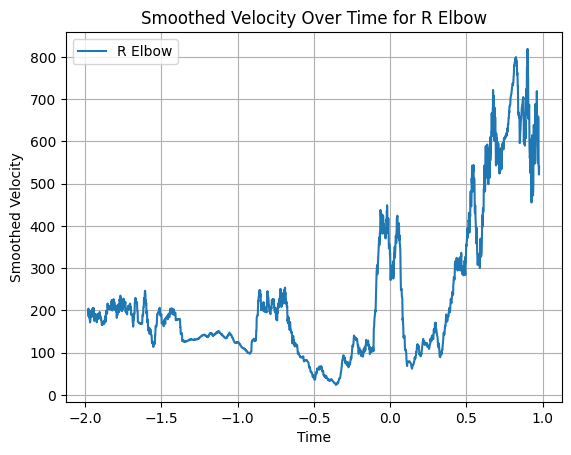

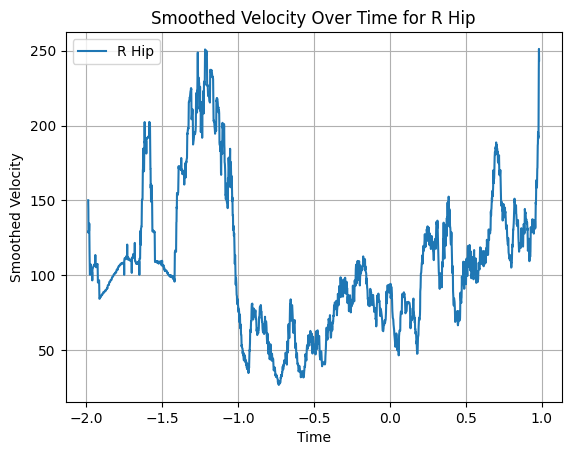

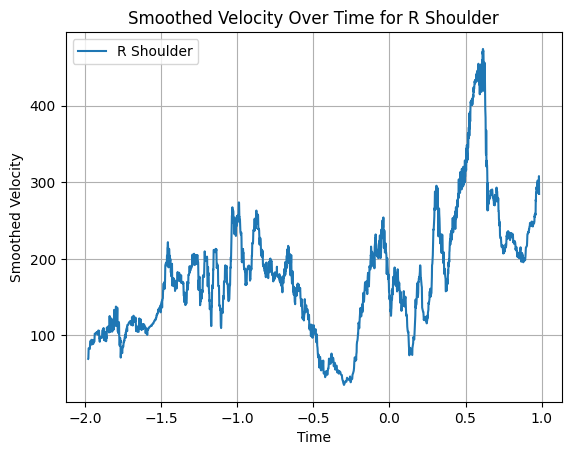

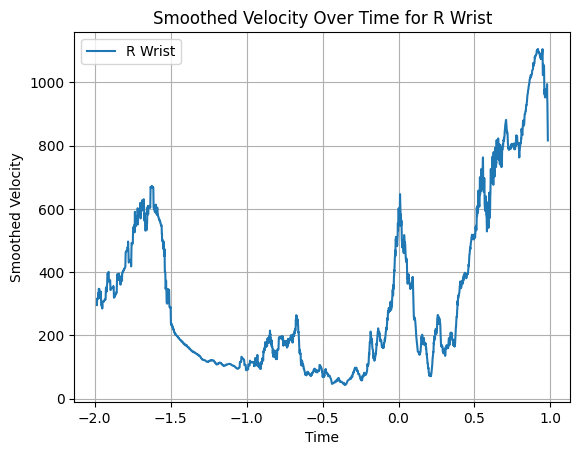

In [67]:
# Smoothed velocity over time

window_size = 20 

for joint_type in joint_types:
    plt.figure()  # Create a new figure for each joint
    joint_data = velo_df[velo_df['joint_type_id'] == joint_type].sort_values(by='time')
    joint_data['smoothed_velocity'] = moving_average(joint_data['velocity'], window_size)
    plt.plot(joint_data['time'], joint_data['smoothed_velocity'], label=joint_names.get(joint_type, f'Joint {joint_type}'))
    plt.xlabel('Time')
    plt.ylabel('Smoothed Velocity')
    plt.title(f'Smoothed Velocity Over Time for {joint_names.get(joint_type, f"Joint {joint_type}")}')
    plt.legend()
    plt.grid(True)
    plt.show()

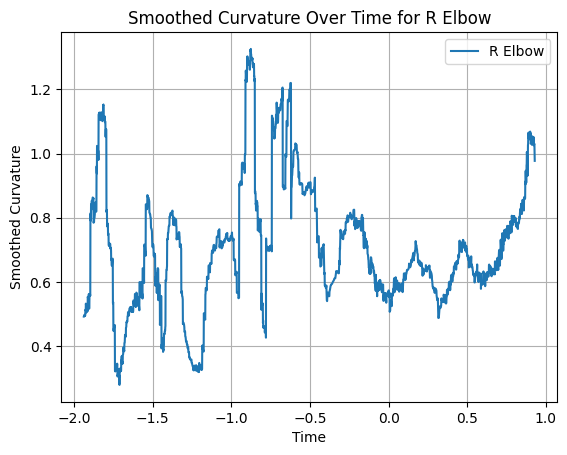

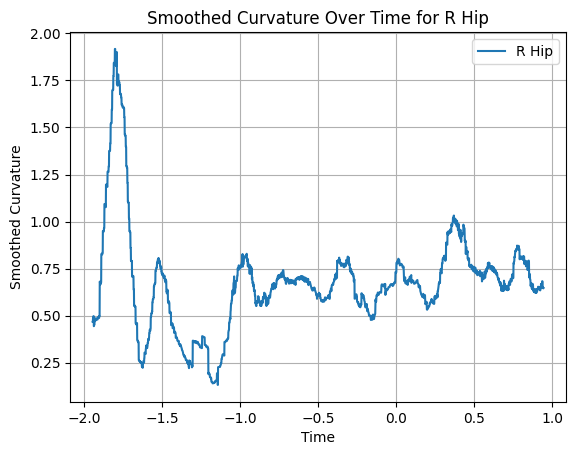

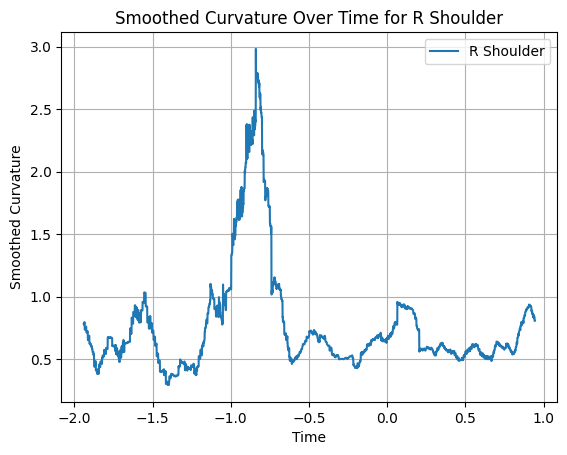

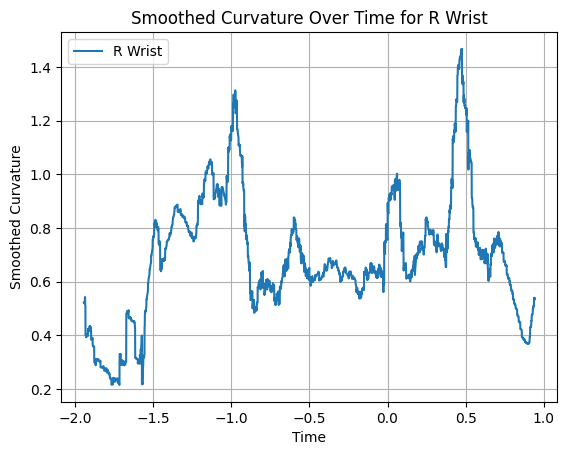

In [68]:
# Smoothed Curvature over time. 

window_size = 100

for joint_type in joint_types:
    plt.figure()  # Create a new figure for each joint
    joint_data = velo_df[velo_df['joint_type_id'] == joint_type].sort_values(by='time')
    joint_data['smoothed_curvature'] = moving_average(joint_data['curvature'], window_size)
    plt.plot(joint_data['time'], joint_data['smoothed_curvature'], label=joint_names.get(joint_type, f'Joint {joint_type}'))
    plt.xlabel('Time')
    plt.ylabel('Smoothed Curvature')
    plt.title(f'Smoothed Curvature Over Time for {joint_names.get(joint_type, f"Joint {joint_type}")}')
    plt.legend()
    plt.grid(True)
    plt.show()

In [69]:
# #**************************************#
# #EXPERIMENT
# # Experimental velocity over curvature.

# window_size = 250  # Adjust the window size for smoothing as needed
# for joint_type in joint_types:
#     plt.figure()  # Create a new figure for each joint
#     joint_data = velo_df[velo_df['joint_type_id'] == joint_type].sort_values(by='time')
#     joint_data['smoothed_curvature'] = moving_average(joint_data['curvature'], window_size)
#     joint_data['smoothed_velocity'] = moving_average(joint_data['velocity'], window_size)
#     plt.plot(joint_data['smoothed_velocity'], joint_data['smoothed_curvature'], label=joint_names.get(joint_type, f'Joint {joint_type}'))
#     plt.xlabel('Smoothed Velocity')
#     plt.ylabel('Smoothed Curvature')
#     plt.title(f'Smoothed Velocity vs Smoothed Curvature for {joint_names.get(joint_type, f"Joint {joint_type}")}')
#     plt.legend()
#     plt.grid(True)
#     plt.show()


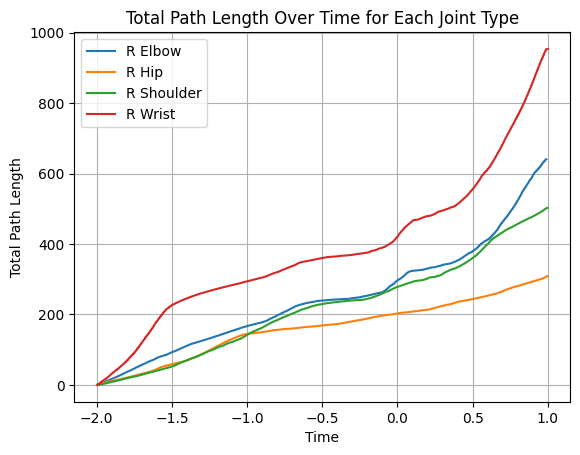

In [70]:
# Function to calculate the cumulative distance traveled by a joint
def calculate_cumulative_distance(df):
    df['distance'] = np.sqrt(df['x'].diff()**2 + df['y'].diff()**2 + df['z'].diff()**2)
    df['cumulative_distance'] = df['distance'].cumsum()
    return df

# Calculate the cumulative distance for each joint type and plot
for joint_type in joint_types:
    joint_data = velo_df[velo_df['joint_type_id'] == joint_type].sort_values(by='time')
    joint_data = calculate_cumulative_distance(joint_data)
    plt.plot(joint_data['time'], joint_data['cumulative_distance'], label=joint_names.get(joint_type, f'Joint {joint_type}'))
    
plt.xlabel('Time')
plt.ylabel('Total Path Length')
plt.title('Total Path Length Over Time for Each Joint Type')
plt.legend()
plt.grid(True)
plt.show()


In [71]:
# Mean over time

# Calculate the mean of 'x', 'y', and 'z' grouped by 'joint_type_id' and 'time'
mean_xyz_df = cleaned_df.groupby(['joint_type_id', 'time']).agg({'x': 'mean', 'y': 'mean', 'z': 'mean'}).reset_index()

# Rename the columns to indicate they contain the mean of 'x', 'y', and 'z'
mean_xyz_per_time_df = mean_xyz_df.rename(columns={'x': 'x_mean', 'y': 'y_mean', 'z': 'z_mean'})

mean_xyz_per_time_df.head()
mean_xyz_per_time_df.info()



<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10378 entries, 0 to 10377
Data columns (total 5 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   joint_type_id  10378 non-null  uint8  
 1   time           10378 non-null  float64
 2   x_mean         10378 non-null  float32
 3   y_mean         10378 non-null  float32
 4   z_mean         10378 non-null  float32
dtypes: float32(3), float64(1), uint8(1)
memory usage: 213.0 KB


In [72]:
# Calculate the mean of 'x', 'y', and 'z' grouped by 'joint_type_id' and 'time'
std_xyz_df = cleaned_df.groupby(['joint_type_id', 'time']).agg({'x': 'std', 'y': 'std', 'z': 'std'}).reset_index()

# Rename the columns to indicate they contain the mean of 'x', 'y', and 'z'
std_xyz_per_time_df = std_xyz_df.rename(columns={'x': 'x_std', 'y': 'y_std', 'z': 'z_std'})

std_xyz_per_time_df.head()
std_xyz_per_time_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10378 entries, 0 to 10377
Data columns (total 5 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   joint_type_id  10378 non-null  uint8  
 1   time           10378 non-null  float64
 2   x_std          10378 non-null  float32
 3   y_std          10378 non-null  float32
 4   z_std          10378 non-null  float32
dtypes: float32(3), float64(1), uint8(1)
memory usage: 213.0 KB


In [73]:
std_xyz_per_time_df = std_xyz_per_time_df.drop(["joint_type_id", "time"],axis=1)

mean_std_df = pd.concat([mean_xyz_per_time_df, std_xyz_per_time_df], axis=1)

mean_std_df.head()

,joint_type_id,time,x_mean,y_mean,z_mean,x_std,y_std,z_std
0,13,-1.993,0.065882,60.946457,5.088882,0.050803,0.055015,0.023632
1,13,-1.990,0.081217,60.942120,5.091925,0.061646,0.057089,0.029311
2,13,-1.989,-0.179430,60.662560,5.086220,0.049398,0.041101,0.020601
3,13,-1.988,-0.139818,60.708008,5.103563,0.049489,0.044925,0.019380
4,13,-1.987,0.046018,60.951992,5.104918,0.047248,0.064360,0.019220


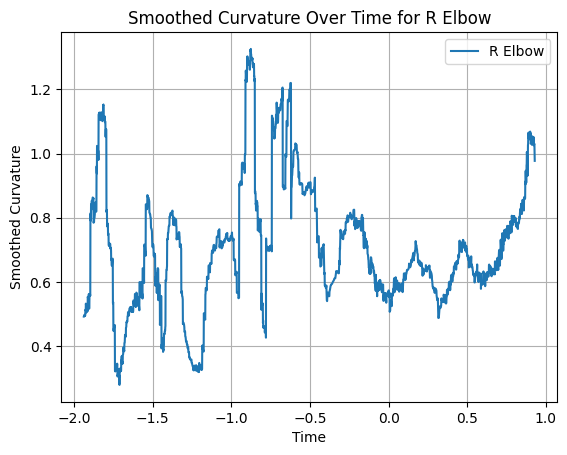

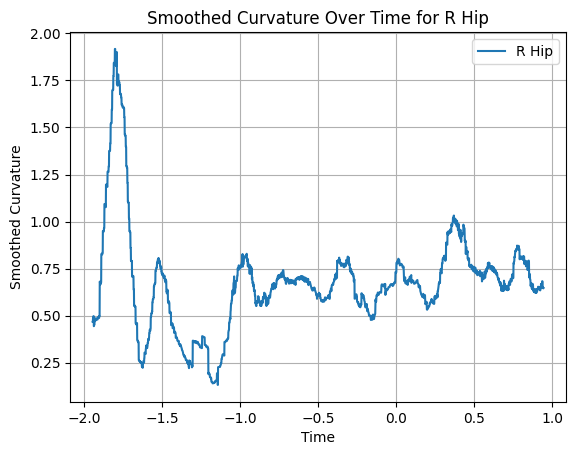

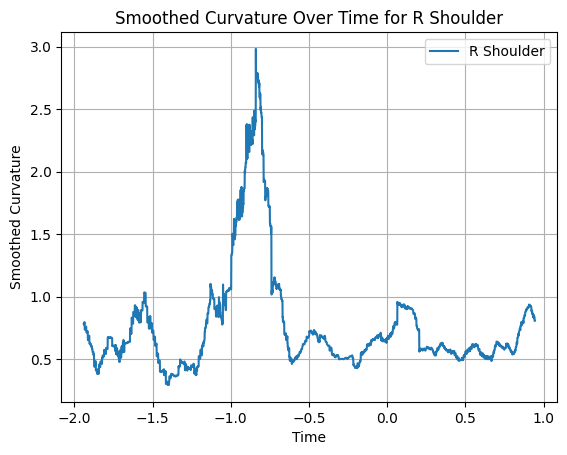

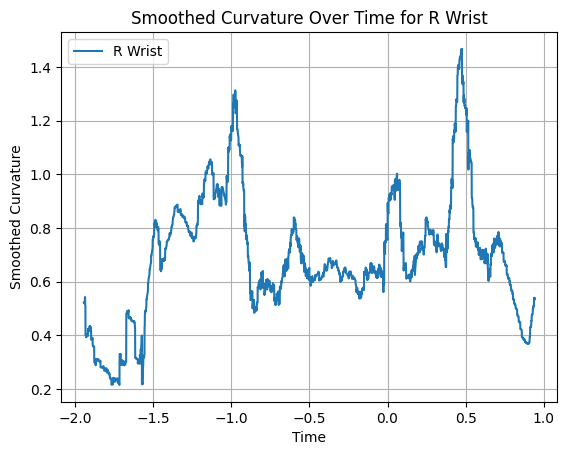

In [74]:
window_size = 100

for joint_type in joint_types:
    plt.figure()  # Create a new figure for each joint
    joint_data = velo_df[velo_df['joint_type_id'] == joint_type].sort_values(by='time')
    joint_data['smoothed_curvature'] = moving_average(joint_data['curvature'], window_size)
    plt.plot(joint_data['time'], joint_data['smoothed_curvature'], label=joint_names.get(joint_type, f'Joint {joint_type}'))
    plt.xlabel('Time')
    plt.ylabel('Smoothed Curvature')
    plt.title(f'Smoothed Curvature Over Time for {joint_names.get(joint_type, f"Joint {joint_type}")}')
    plt.legend()
    plt.grid(True)
    plt.show()

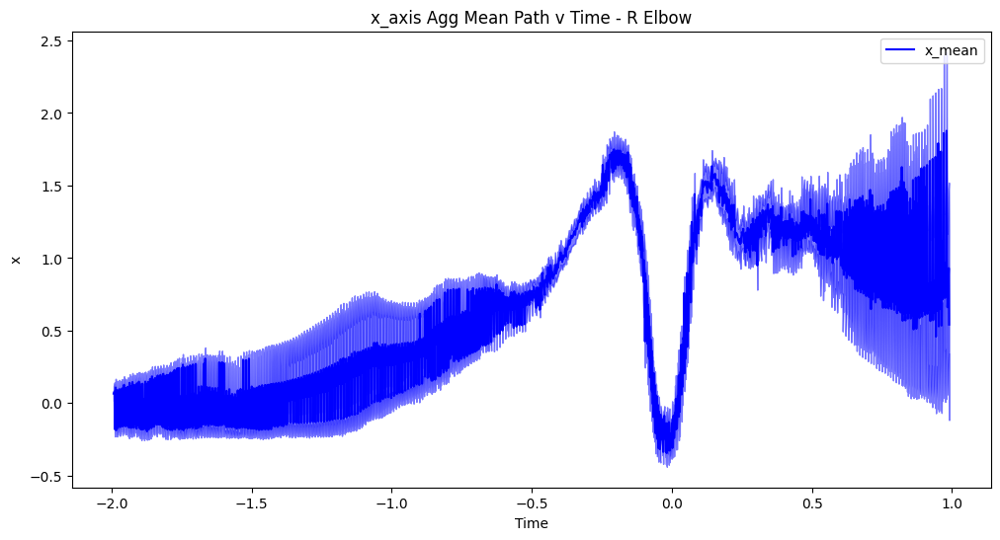

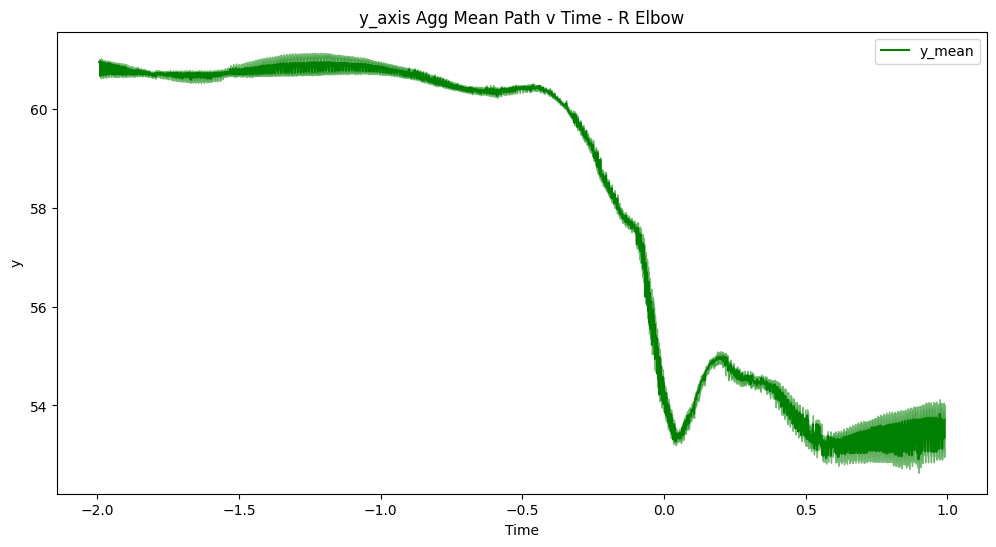

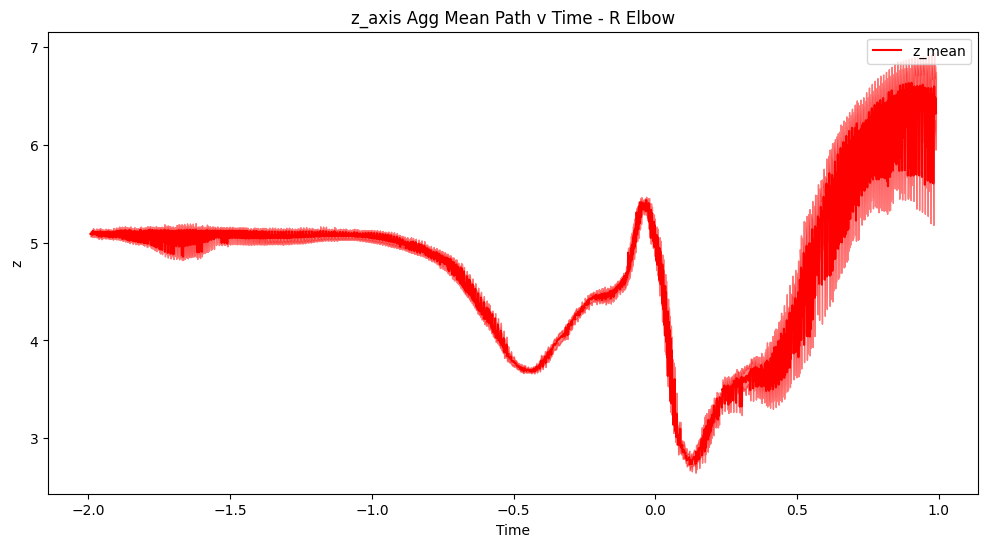

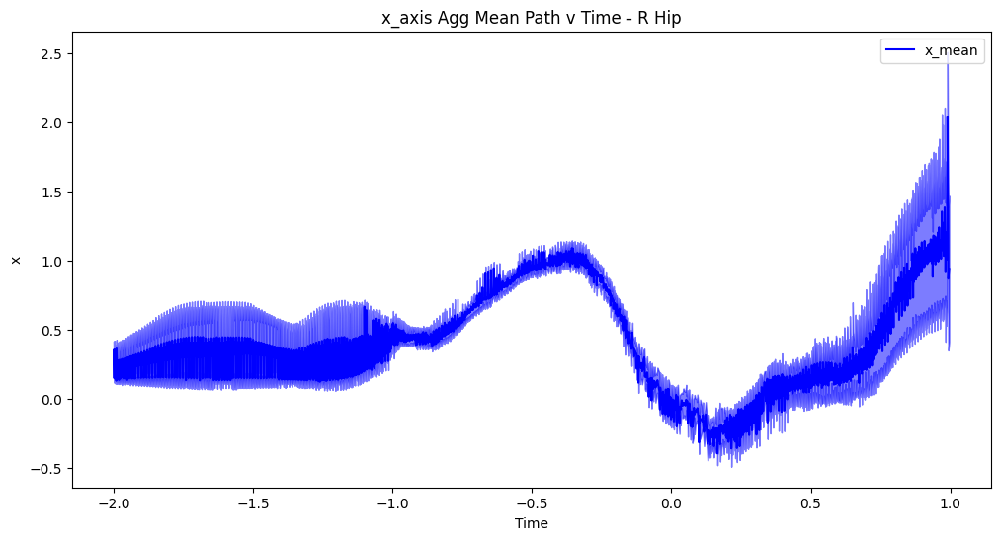

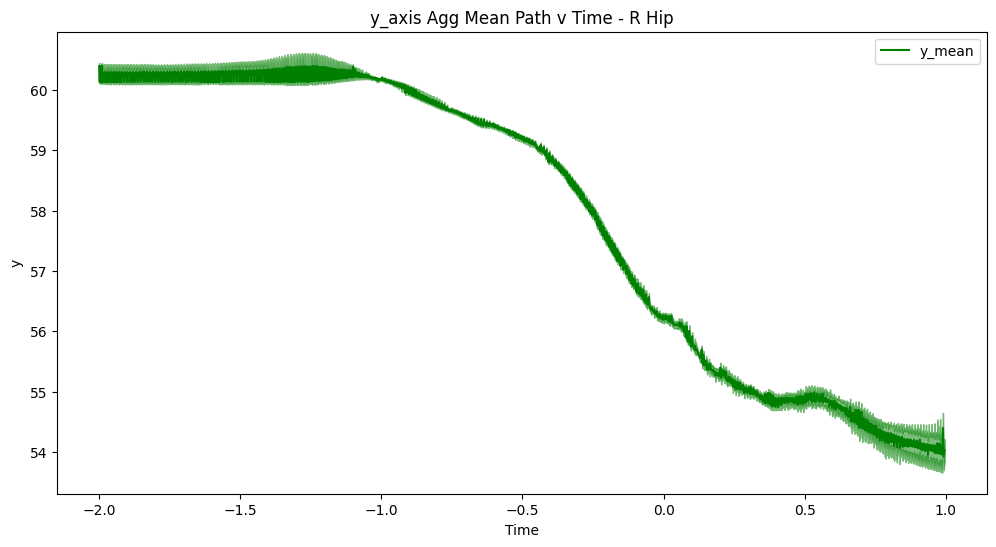

...

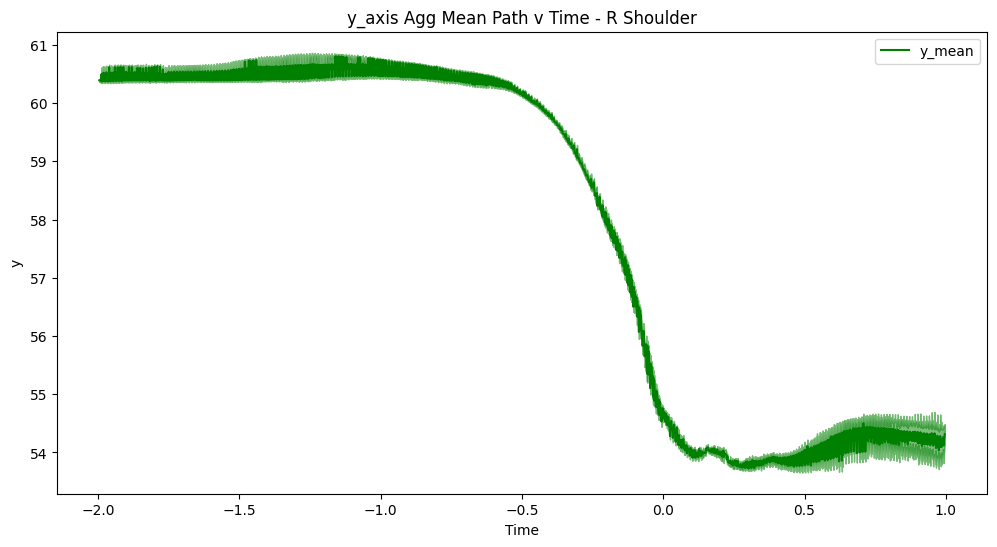

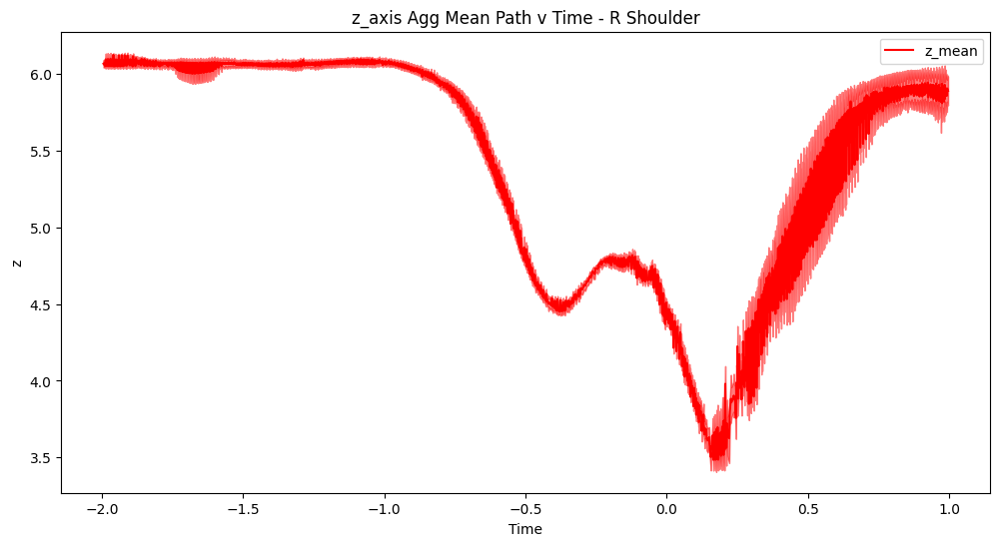

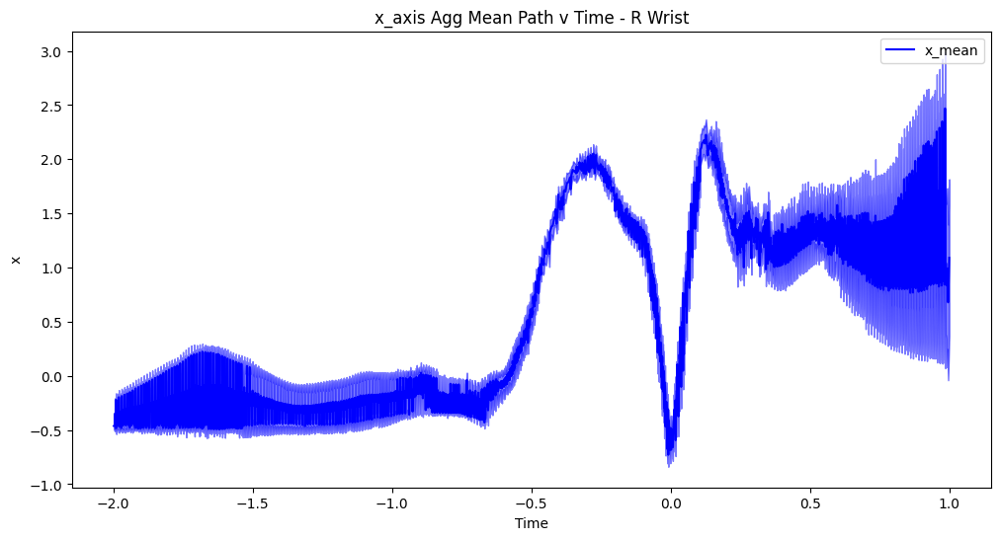

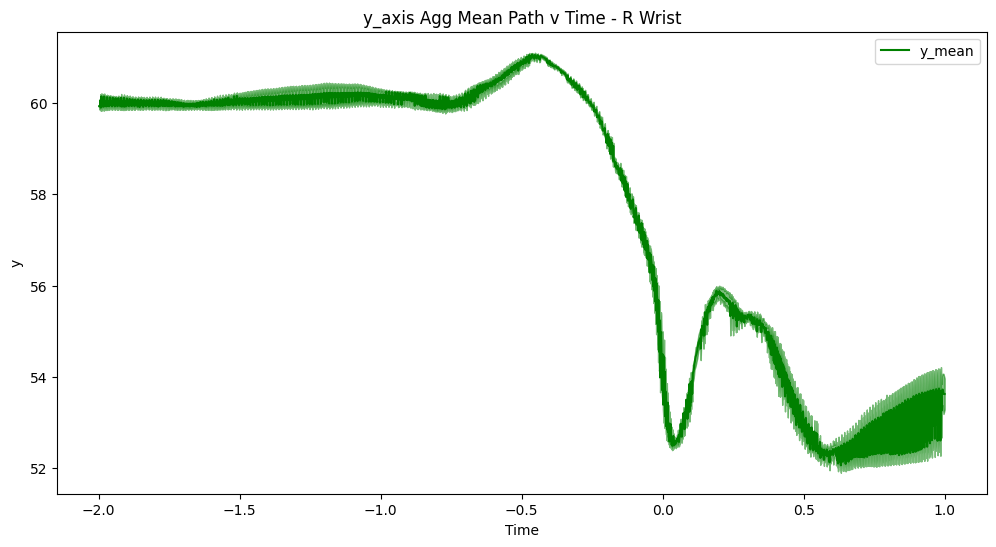

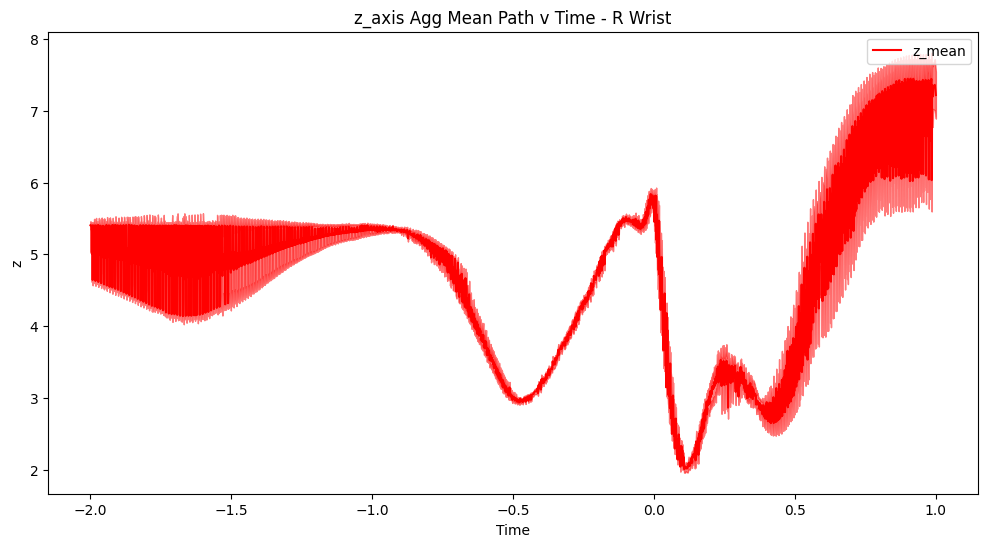

In [75]:
# Iterate over unique 'joint_type_id' values
for joint_type_id in mean_std_df['joint_type_id'].unique():
    # Filter mean_std_df for the current 'joint_type_id'
    df = mean_std_df[mean_std_df['joint_type_id'] == joint_type_id]
    
    # Get the joint type name
    joint_type_name = joint_names[joint_type_id]
    
    # Plot 'x_mean' with 'x_std' and '-x_std' over time
    plt.figure(figsize=(12, 6))
    plt.plot(df['time'], df['x_mean'], label='x_mean', color='blue')
    plt.fill_between(df['time'], df['x_mean'] - df['x_std'], df['x_mean'] + df['x_std'], alpha=0.3, color='blue')
    plt.fill_between(df['time'], df['x_mean'] + df['x_std'], df['x_mean'] - df['x_std'], alpha=0.3, color='blue')
    plt.xlabel('Time')
    plt.ylabel('x')
    plt.title(f'x_axis Agg Mean Path v Time - {joint_type_name}')
    plt.legend()
    plt.show()

    # Plot 'y_mean' with 'y_std' and '-y_std' over time
    plt.figure(figsize=(12, 6))
    plt.plot(df['time'], df['y_mean'], label='y_mean', color='green')
    plt.fill_between(df['time'], df['y_mean'] - df['y_std'], df['y_mean'] + df['y_std'], alpha=0.3, color='green')
    plt.fill_between(df['time'], df['y_mean'] + df['y_std'], df['y_mean'] - df['y_std'], alpha=0.3, color='green')
    plt.xlabel('Time')
    plt.ylabel('y')
    plt.title(f'y_axis Agg Mean Path v Time - {joint_type_name}')
    plt.legend()
    plt.show()

    # Plot 'z_mean' with 'z_std' and '-z_std' over time
    plt.figure(figsize=(12, 6))
    plt.plot(df['time'], df['z_mean'], label='z_mean', color='red')
    plt.fill_between(df['time'], df['z_mean'] - df['z_std'], df['z_mean'] + df['z_std'], alpha=0.3, color='red')
    plt.fill_between(df['time'], df['z_mean'] + df['z_std'], df['z_mean'] - df['z_std'], alpha=0.3, color='red')
    plt.xlabel('Time')
    plt.ylabel('z')
    plt.title(f'z_axis Agg Mean Path v Time - {joint_type_name}')
    plt.legend()
    plt.show()
